In [2]:
 import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sb
import plotly.express as px
!pip install xlrd


Выгрузка и чтение датасет X_1(Характеристика многоквартирных домов)


In [3]:
X_1_xlsx = 'E:\Data10\X_1.xlsx'

X_1 = pd.read_excel(X_1_xlsx, header=1)

Вывод первых 5 строк датасет

In [4]:
print(X_1.head())

   Unnamed: 0                                 Unnamed: 1  Unnamed: 2  \
0     1500923      Дом по адресу Красковская ул., д.121А         NaN   
1     1500933   Дом по адресу Байкальская ул., д.18, к.2         NaN   
2     1500943          Дом по адресу Перовская ул., д.48         NaN   
3     1500951  Дом по адресу Парковая 3-я ул., д.39, к.3         NaN   
4     1500954  Дом по адресу Свободный просп., д.11, к.2         NaN   

  Unnamed: 3 Назначение  Форма собственности  Год постройки  \
0         WS        NaN                  NaN         1956.0   
1         WS        NaN                  NaN         2005.0   
2         WS        NaN                  NaN         1955.0   
3  404070001        NaN                  NaN         1960.0   
4         WS        NaN                  NaN         1973.0   

   Год реконструкции  Серия проекта  Количество этажей  ...  \
0                NaN      2048798.0                1.0  ...   
1                NaN      2048798.0               18.0  ...   

In [5]:
X_1 = X_1.rename(columns={X_1.columns[0]: 'ID',
                          X_1.columns[1]: 'NAME',
                          X_1.columns[2]: 'PARENT_ID', 
                          X_1.columns[3]: 'LOGIN'})

In [6]:
print(X_1.head())

        ID                                       NAME  PARENT_ID      LOGIN  \
0  1500923      Дом по адресу Красковская ул., д.121А        NaN         WS   
1  1500933   Дом по адресу Байкальская ул., д.18, к.2        NaN         WS   
2  1500943          Дом по адресу Перовская ул., д.48        NaN         WS   
3  1500951  Дом по адресу Парковая 3-я ул., д.39, к.3        NaN  404070001   
4  1500954  Дом по адресу Свободный просп., д.11, к.2        NaN         WS   

  Назначение  Форма собственности  Год постройки  Год реконструкции  \
0        NaN                  NaN         1956.0                NaN   
1        NaN                  NaN         2005.0                NaN   
2        NaN                  NaN         1955.0                NaN   
3        NaN                  NaN         1960.0                NaN   
4        NaN                  NaN         1973.0                NaN   

   Серия проекта  Количество этажей  ...  Очередность уборки кровли  \
0      2048798.0           

общие данные 

In [7]:
X_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18432 entries, 0 to 18431
Data columns (total 32 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   ID                                   18432 non-null  int64  
 1   NAME                                 18432 non-null  object 
 2   PARENT_ID                            22 non-null     float64
 3   LOGIN                                18432 non-null  object 
 4   Назначение                           4155 non-null   object 
 5   Форма собственности                  0 non-null      float64
 6   Год постройки                        18374 non-null  float64
 7   Год реконструкции                    1 non-null      float64
 8   Серия проекта                        18373 non-null  float64
 9   Количество этажей                    18374 non-null  float64
 10  Количество подъездов                 18353 non-null  float64
 11  Количество квартир          

Переменование 

In [7]:
X_1 = X_1.rename(columns={'UNOM': 'unom'})

In [9]:
X_1.describe().T

,count,mean,std,min,25%,50%,75%,max
ID,18432.0,9.745974e+07,6.656435e+07,1500923.0,1534569.75,137677536.5,1.376824e+08,545483953.0
PARENT_ID,22.0,1.459672e+06,7.022012e+02,1457996.0,1459745.00,1459798.0,1.460117e+06,1460514.0
Форма собственности,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Год постройки,18374.0,1.789304e+03,5.652257e+02,0.0,1952.00,1966.0,1.981000e+03,2020.0
Год реконструкции,1.0,1.955000e+03,NaN,1955.0,1955.00,1955.0,1.955000e+03,1955.0
Серия проекта,18373.0,2.971383e+06,7.192604e+06,2048744.0,2048798.00,2048798.0,2.048912e+06,179773920.0
Количество этажей,18374.0,3.422989e+00,4.055838e+00,0.0,1.00,1.0,5.000000e+00,37.0
Количество подъездов,18353.0,9.976571e-01,1.868189e+00,0.0,0.00,0.0,1.000000e+00,15.0
Количество квартир,5617.0,9.046252e+01,9.293266e+01,0.0,30.00,75.0,1.160000e+02,1845.0
Общая площадь,18373.0,2.624641e+03,5.733589e+03,0.0,99.00,544.0,3.503000e+03,202137.0


In [10]:
X_1.nunique()

ID                                     18432
NAME                                   18389
PARENT_ID                                 11
LOGIN                                     21
Назначение                                 5
Форма собственности                        0
Год постройки                            184
Год реконструкции                          1
Серия проекта                            141
Количество этажей                         36
Количество подъездов                      16
Количество квартир                       377
Общая площадь                           6022
Общая площадь жилых помещений           3381
Общая площадь нежилых помещений         3882
Строительный объем                         1
Износ объекта (по БТИ)                     1
Класс энергоэффективности                  0
Материал стен                             37
Признак аварийности здания                 2
Количество пассажирских лифтов            23
Количество грузопассажирских лифтов       16
Очередност

In [11]:
X_1.isnull().sum()

ID                                         0
NAME                                       0
PARENT_ID                              18410
LOGIN                                      0
Назначение                             14277
Форма собственности                    18432
Год постройки                             58
Год реконструкции                      18431
Серия проекта                             59
Количество этажей                         58
Количество подъездов                      79
Количество квартир                     12815
Общая площадь                             59
Общая площадь жилых помещений             77
Общая площадь нежилых помещений           77
Строительный объем                     17718
Износ объекта (по БТИ)                 17718
Класс энергоэффективности              18432
Материал стен                             59
Признак аварийности здания             12759
Количество пассажирских лифтов            74
Количество грузопассажирских лифтов       74
Очередност

In [12]:
X_1.corr(method = 'kendall')

,ID,PARENT_ID,Форма собственности,Год постройки,Год реконструкции,Серия проекта,Количество этажей,Количество подъездов,Количество квартир,Общая площадь,...,Количество грузопассажирских лифтов,Очередность уборки кровли,Материал кровли,unom,Вид социального объекта,Тип жилищного фонда,Статус МКД,Статус управления МКД,Количество грузовых лифтов,Категория МКД
ID,1.000000,-0.018161,NaN,0.050602,NaN,0.207520,-0.440750,-0.599985,-0.014040,-0.359619,...,-0.171382,0.011752,0.018551,0.907653,NaN,-0.060008,0.630041,-0.018347,0.031604,NaN
PARENT_ID,-0.018161,1.000000,NaN,-0.080855,NaN,-0.152726,-0.091820,-0.148338,-0.105355,-0.027242,...,-0.075530,NaN,NaN,-0.063564,NaN,-0.078246,-0.316228,0.738549,NaN,NaN
Форма собственности,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Год постройки,0.050602,-0.080855,NaN,1.000000,NaN,-0.097552,0.125799,-0.024333,0.541566,0.147165,...,0.198093,0.216882,-0.502106,0.055712,NaN,0.275652,0.019498,0.152134,0.033838,NaN
Год реконструкции,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Серия проекта,0.207520,-0.152726,NaN,-0.097552,NaN,1.000000,-0.207299,-0.206207,-0.121427,-0.229647,...,-0.134942,-0.071743,0.239162,0.206289,NaN,0.001903,0.216249,-0.032809,-0.026085,NaN
Количество этажей,-0.440750,-0.091820,NaN,0.125799,NaN,-0.207299,1.000000,0.511757,0.678407,0.685985,...,0.351468,-0.081824,-0.597365,-0.448742,NaN,0.565563,-0.556478,0.172758,0.088821,NaN
Количество подъездов,-0.599985,-0.148338,NaN,-0.024333,NaN,-0.206207,0.511757,1.000000,0.279544,0.392938,...,0.216189,0.003482,-0.046392,-0.607707,NaN,0.169382,-0.910906,-0.020971,-0.079339,NaN
Количество квартир,-0.014040,-0.105355,NaN,0.541566,NaN,-0.121427,0.678407,0.279544,1.000000,0.799185,...,0.361555,0.074276,-0.560856,-0.124466,NaN,0.529297,0.061718,0.127453,0.029514,NaN
Общая площадь,-0.359619,-0.027242,NaN,0.147165,NaN,-0.229647,0.685985,0.392938,0.799185,1.000000,...,0.290634,-0.069601,-0.487403,-0.367662,NaN,0.516535,-0.386031,0.154825,0.119655,NaN


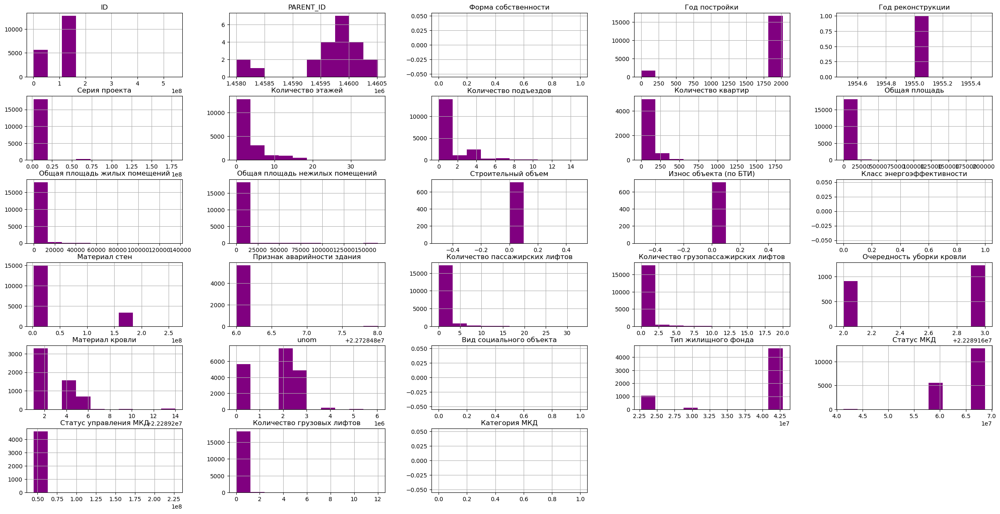

In [13]:
X_1.hist(figsize = (30,15),color='purple')
plt.show()

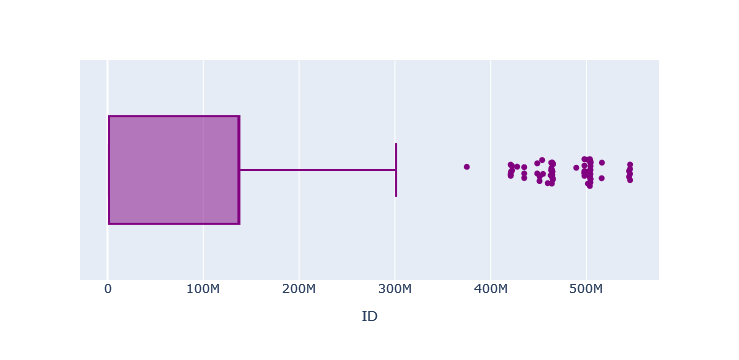

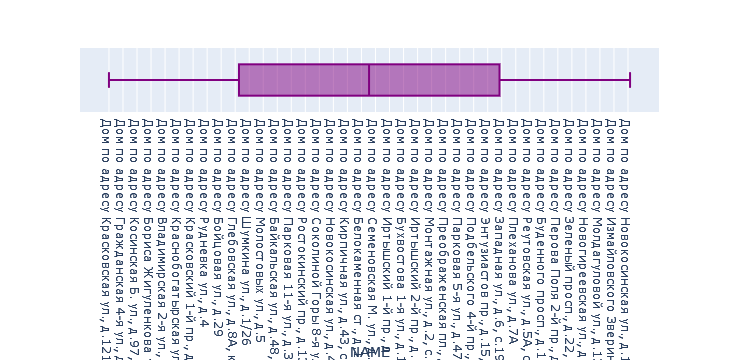

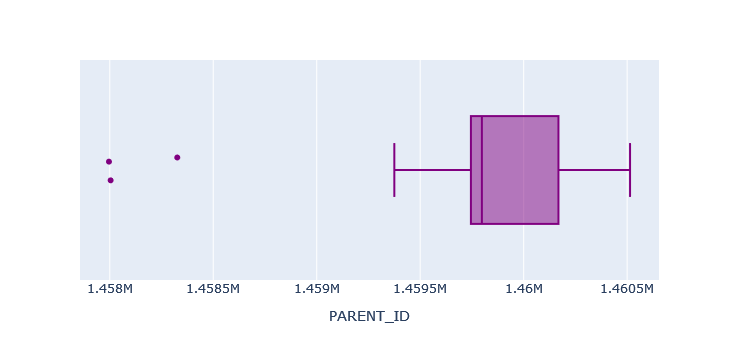

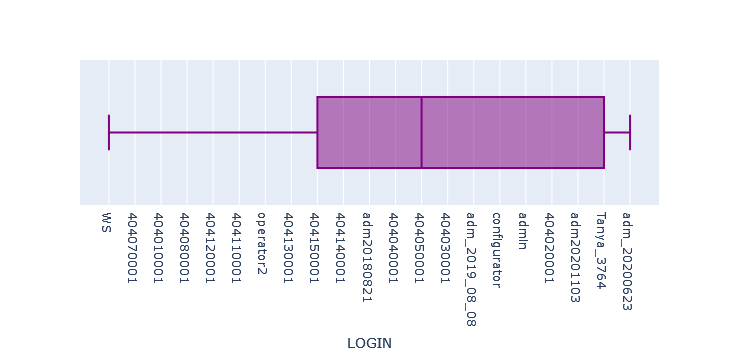

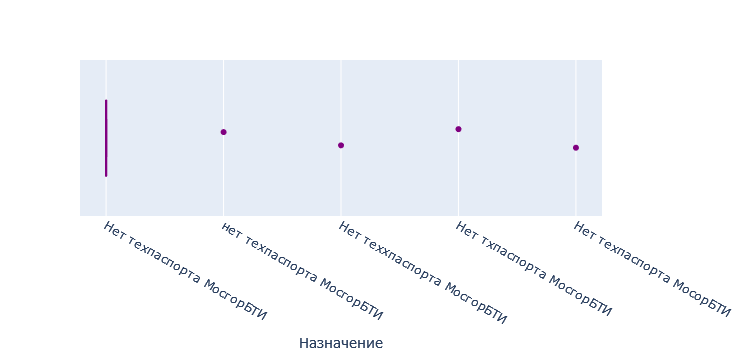

...

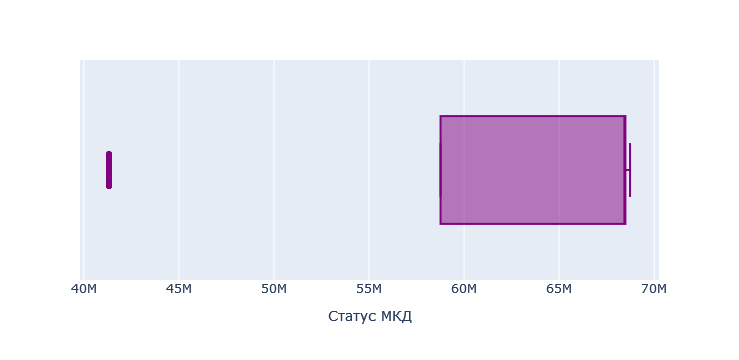

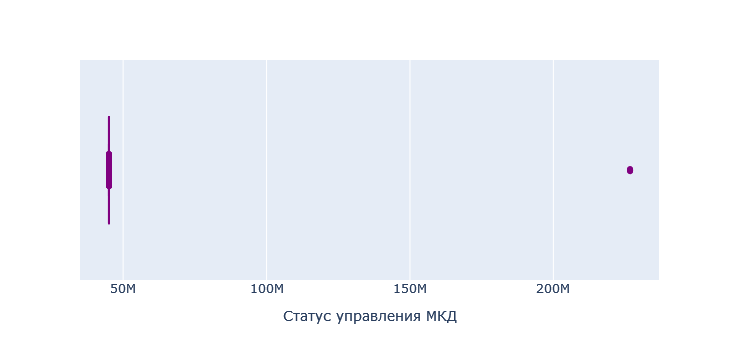

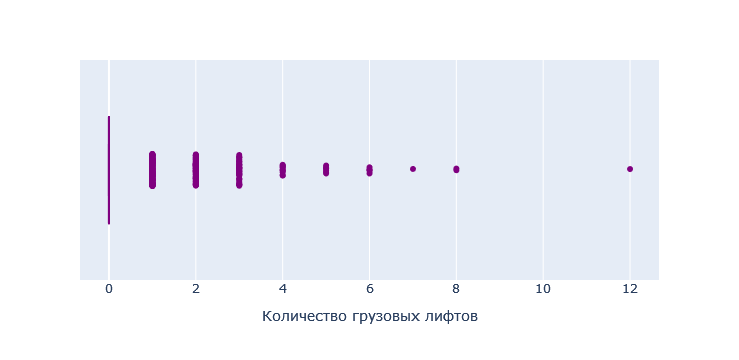

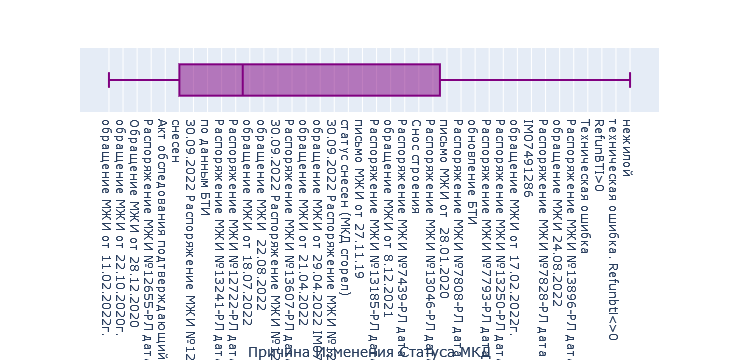

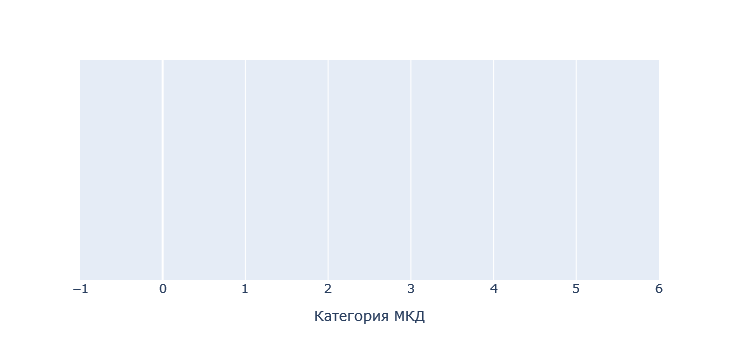

In [75]:
for column in X_1.columns: 
    fig = px.box(X_1, x=column, color_discrete_sequence=["purple"])
    fig.update_traces(marker=dict(color='purple'), boxpoints="outliers", jitter=0.3)
    fig.show()

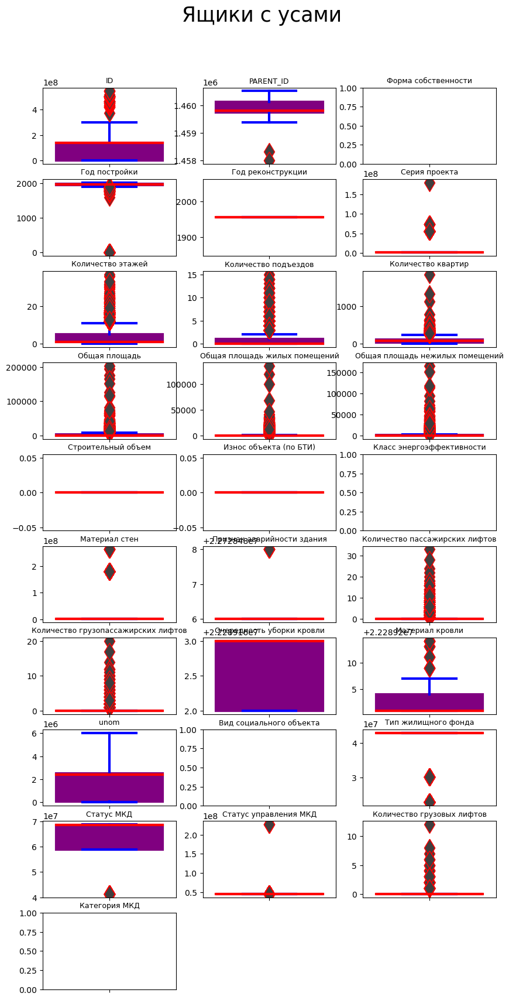

In [79]:
num_of_cols = sum((X_1.dtypes == 'int64') | (X_1.dtypes == 'float64'))#проверка числа столбцов
a = num_of_cols // 3 # используйте // для целочисленного деления
if num_of_cols % 3: # если остаток от деления на 3 не равен 0, +1 дополнительная строка
    a += 1
b = 3 # Столбцы
c = 1 # Плот

plt.figure(figsize=(10, 20))
plt.suptitle('Ящики с усами', y=0.95, fontsize=25)

for col in X_1.columns:
    if X_1[col].dtype in ['int64', 'float64']: #для числового типа данных столбца 
        plt.subplot(a, b, c)
        sb.boxplot(data = X_1, y = X_1[col], fliersize = 15, linewidth = 3, 
                   medianprops = dict(color = 'r'),
                   whiskerprops = dict(color = 'b'), 
                   capprops = dict(color = 'b'), 
                   flierprops = dict(color = 'r', markeredgecolor = 'r'),
                   boxprops = dict(facecolor = 'purple', color='purple'))
        plt.ylabel(None)
        plt.title(col, size=0.9 * plt.rcParams['font.size'])
        c += 1

plt.show()

ID


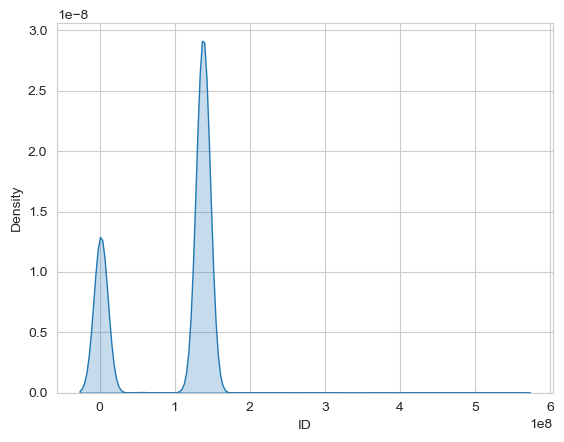

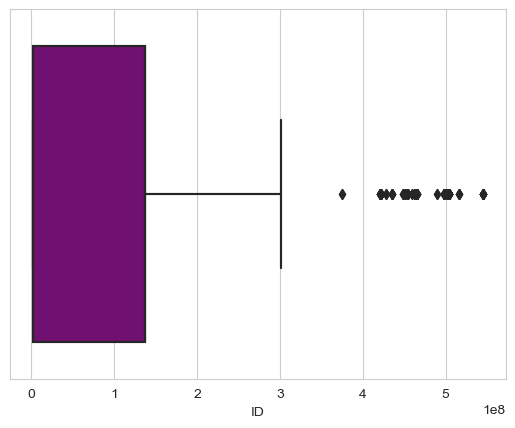

Минимальное значение:  1500923
Максимальное значение:  545483953
Среднее значение:  97459736.19699436
Медианное значение:  137677536.5



NAME


TypeError: The x variable is categorical, but one of ['numeric', 'datetime'] is required

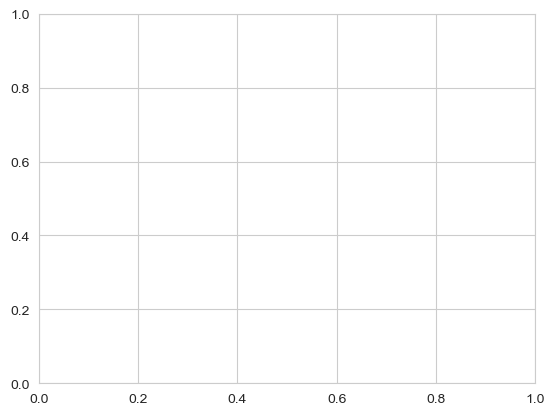

In [8]:
for column_name in X_1.columns:
    print(column_name)
    
    #Гистограмма распределения
    gis = X_1[column_name]
    sb.set_style("whitegrid")
    sb.kdeplot(data = gis, fill = True)
    plt.show()
    
    #Диаграмма "Ящик с усами"
    sb.boxplot(x=gis);
    sb.boxplot(x=gis, color='purple')
    plt.show()
    
    #Значения
    print("Минимальное значение: ", end = " ")
    print(np.min(gis))
    print("Максимальное значение: ", end=" ")
    print(np.max(gis))
    print("Среднее значение: ", end = " ")
    print(np.mean(gis))
    print("Медианное значение: ", end = " ")
    print(np.median(gis))
    print("\n\n")